## 6232 Курицын Никита
2 ЛР по Data Visualization
Дата выполнения: 23.10.2024

## Подключение необходимых библиотек

In [157]:
from plotnine import *
from plotnine.data import *

import numpy as np
import pandas as pd

import warnings

## Тестовый датафрейм "mpg"

In [6]:
mpg

,manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
0,audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
1,audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
2,audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
3,audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact
4,audi,a4,2.8,1999,6,auto(l5),f,16,26,p,compact
...,...,...,...,...,...,...,...,...,...,...,...
229,volkswagen,passat,2.0,2008,4,auto(s6),f,19,28,p,midsize
230,volkswagen,passat,2.0,2008,4,manual(m6),f,21,29,p,midsize
231,volkswagen,passat,2.8,1999,6,auto(l5),f,16,26,p,midsize
232,volkswagen,passat,2.8,1999,6,manual(m5),f,18,26,p,midsize


## Простейшая визуализация с использованиме geom_point по осям displ и hwy

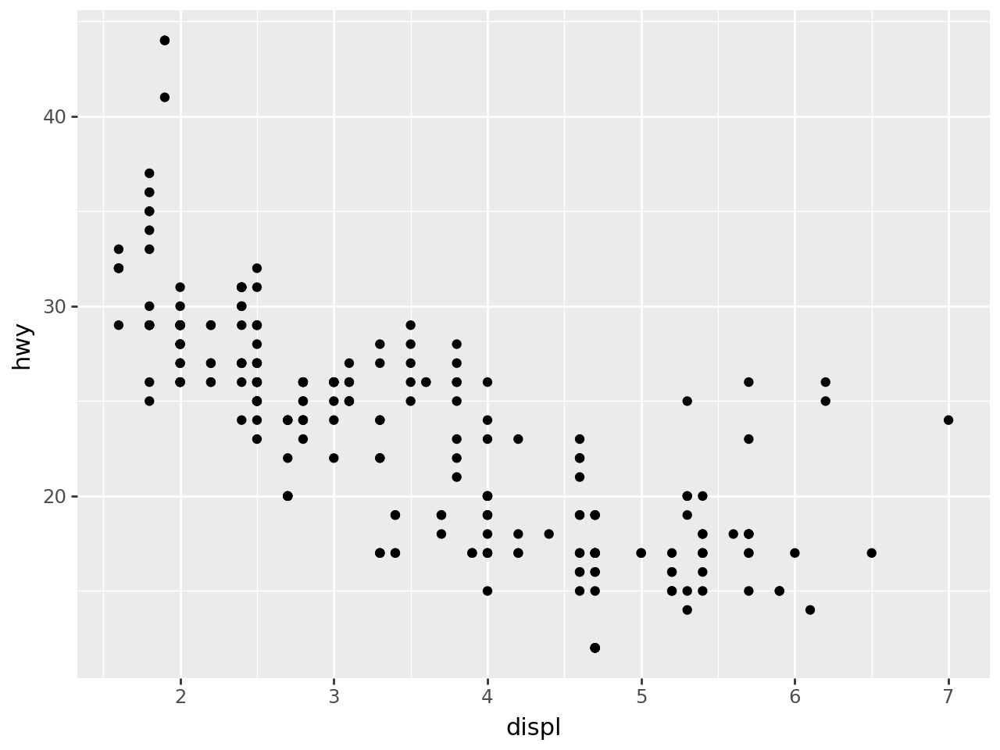

In [14]:
ggplot(data=mpg) + geom_point(mapping=aes(x="displ", y="hwy"))

### Постройте два графика: в одном из них одна из осей должна быть соответствовать столбцу с элементами-категориями, во втором – обе (например, "class" и "drv")


C:\Users\Никита\AppData\Local\Temp\ipykernel_8500\527245162.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


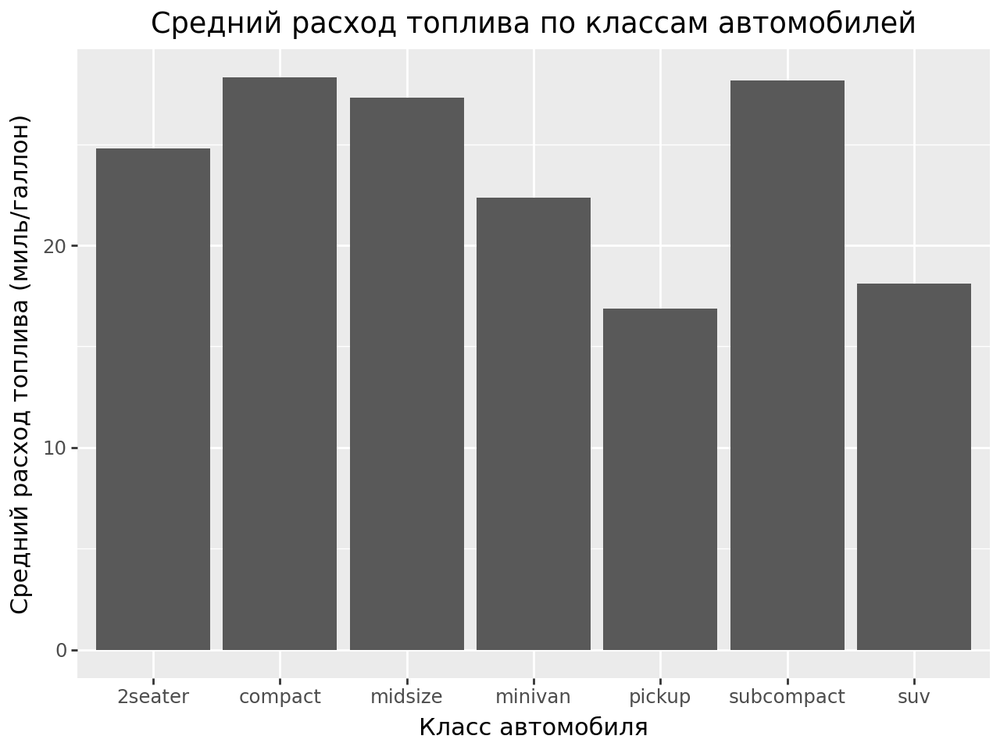

In [33]:
# Type your code here...
average_fuel_by_class = mpg.groupby('class')['hwy'].mean().reset_index()
ggplot(data=average_fuel_by_class) + geom_bar(mapping=aes(x="class", y="hwy"), stat='identity') + \
labs(title="Средний расход топлива по классам автомобилей", x="Класс автомобиля", y="Средний расход топлива (миль/галлон)")

C:\Users\Никита\AppData\Local\Temp\ipykernel_8500\1277660734.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


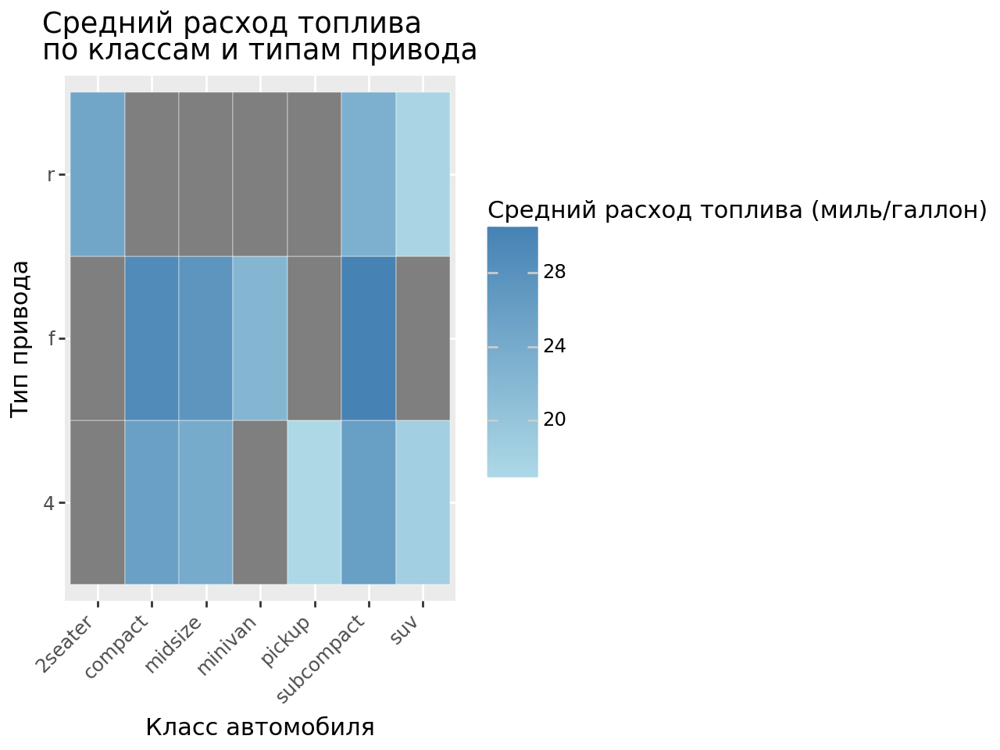

In [63]:
# Type your code here...
average_fuel_by_class_drv = mpg.groupby(['class', 'drv'])['hwy'].mean().reset_index()
ggplot(average_fuel_by_class_drv, aes(x='class', y='drv', fill='hwy')) +\
geom_tile(aes(fill='hwy'), color='white') +\
scale_fill_gradient(low="lightblue", high="steelblue") +\
labs(title="Средний расход топлива \nпо классам и типам привода", 
         x="Класс автомобиля", 
         y="Тип привода", 
         fill="Средний расход топлива (миль/галлон)") +\
 theme(axis_text_x=element_text(rotation=45, hjust=1))

## Добавим красок, оттенков и форм в графики

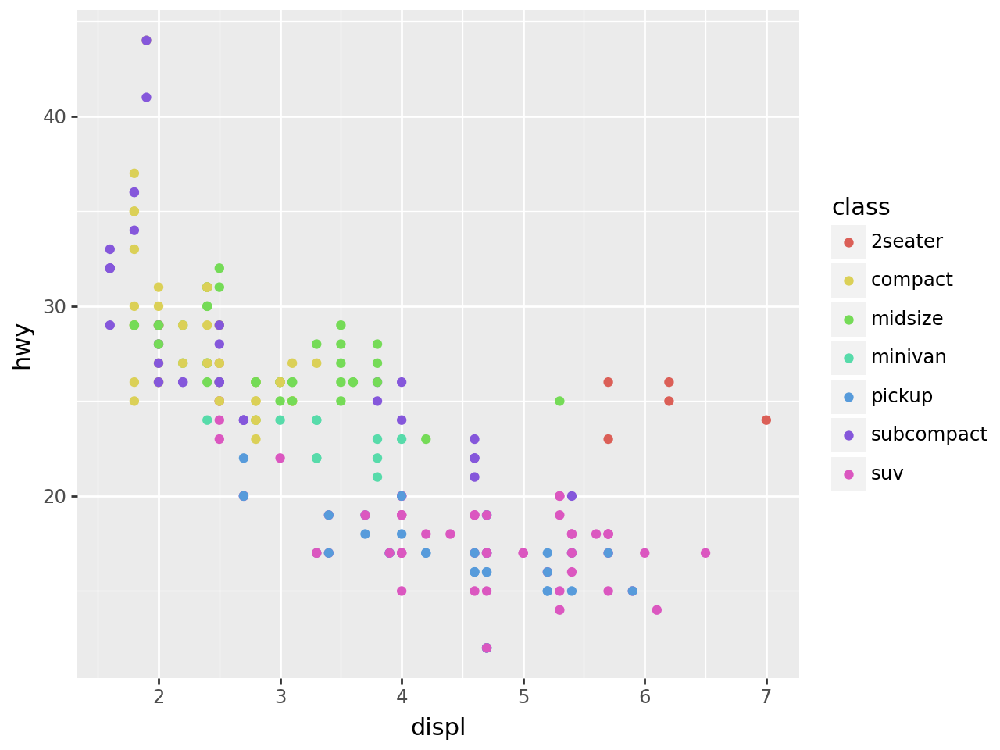

In [64]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy", color="class"))

C:\Users\Никита\AppData\Local\Programs\Python\Python312\Lib\site-packages\plotnine\scales\scale_alpha.py:76: PlotnineWarning: Using alpha for a discrete variable is not advised.


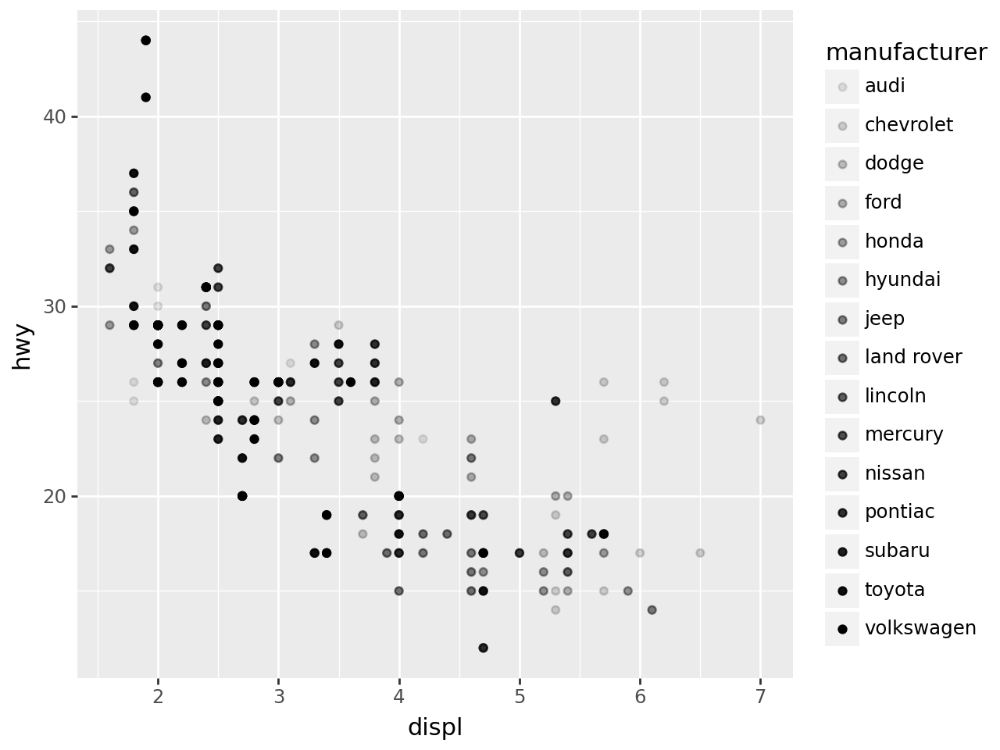

In [68]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy", alpha="manufacturer"))

### Попробуйте сделать два графика: в одном размер точек будет соответствовать столбцу с элементами-категориями, во втором – столбцу с элементами-значениями

C:\Users\Никита\AppData\Local\Programs\Python\Python312\Lib\site-packages\plotnine\scales\scale_size.py:51: PlotnineWarning: Using size for a discrete variable is not advised.


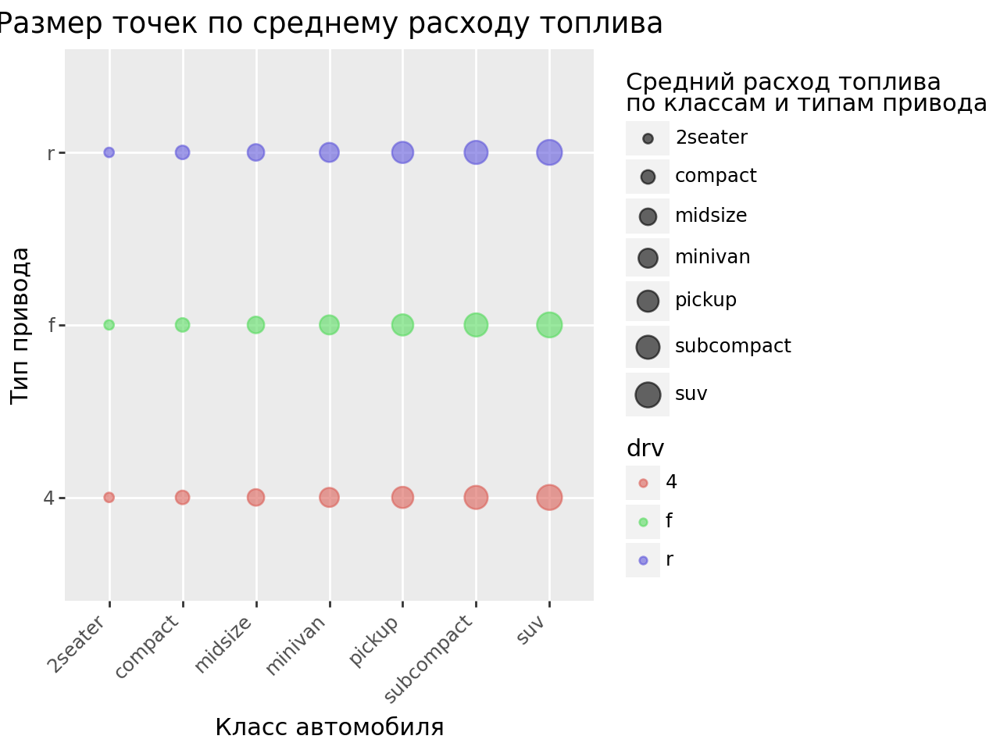

In [79]:
# Type your code here...
ggplot(average_fuel_by_class_drv, aes(x='class', y='drv', size='class', color='drv')) +\
geom_point(alpha=0.6) +\
labs(title="Размер точек по среднему расходу топлива", 
         x="Класс автомобиля", 
         y="Тип привода", 
         size="Средний расход топлива \nпо классам и типам привода") +\
theme(axis_text_x=element_text(rotation=45, hjust=1))

C:\Users\Никита\AppData\Local\Programs\Python\Python312\Lib\site-packages\plotnine\layer.py:364: PlotnineWarning: geom_point : Removed 9 rows containing missing values.


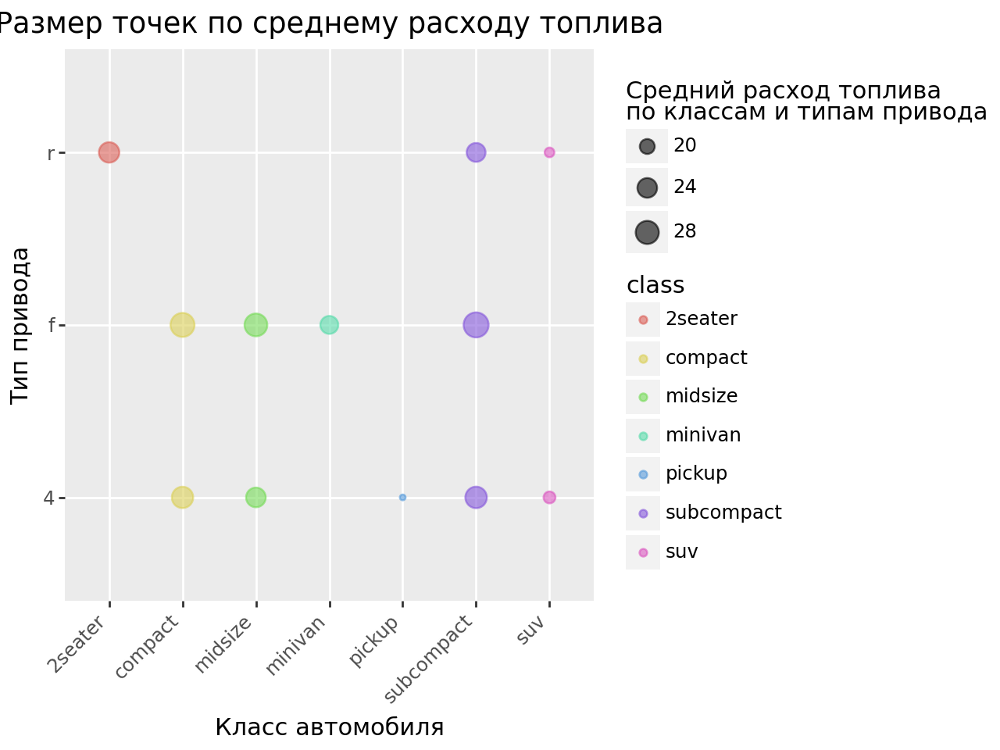

In [84]:
# Type your code here...
ggplot(average_fuel_by_class_drv, aes(x='class', y='drv', size='hwy', color='class')) +\
geom_point(alpha=0.6) +\
labs(title="Размер точек по среднему расходу топлива", 
         x="Класс автомобиля", 
         y="Тип привода", 
         size="Средний расход топлива \nпо классам и типам привода") +\
theme(axis_text_x=element_text(rotation=45, hjust=1))

## А что если сделать использовать в качестве источника визуального свойства "форма" непрерывную категорию (например hwy)?

In [97]:
# Type your code here...
average_fuel_by_class_drv['hwy'] = average_fuel_by_class_drv['hwy'].fillna(0)
average_fuel_by_class_drv['hwy_category'] = pd.cut(
    average_fuel_by_class_drv['hwy'],
    bins=[0, 15, 17, 20, 23, 27, 32],
    labels=["0-15", "15-17", "18-20", "21-23", "24-27", "28-32"],
    include_lowest=True
)

C:\Users\Никита\AppData\Local\Programs\Python\Python312\Lib\site-packages\plotnine\scales\scale_shape.py:88: PlotnineWarning: Using shapes for an ordinal variable is not advised.


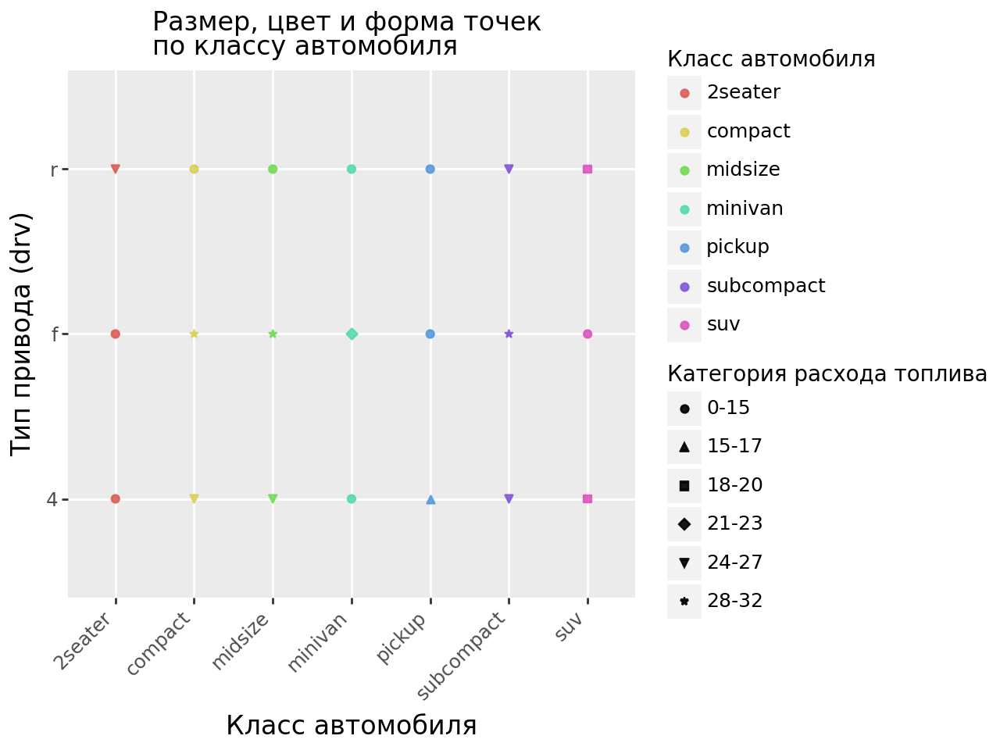

In [113]:
ggplot(average_fuel_by_class_drv, aes(x='class', y='drv', color='class', shape='hwy_category'))+\
geom_point(alpha=0.9) +\
 labs(title="Размер, цвет и форма точек \nпо классу автомобиля",
         x="Класс автомобиля",
         y="Тип привода (drv)",
         size="Средний расход топлива",
         color="Класс автомобиля",
         shape="Категория расхода топлива") +\
theme(axis_text_x=element_text(rotation=45, hjust=1),  # Поворот меток по оси X
          legend_position='right',  # Положение легенды
          legend_title=element_text(size=10),  # Размер заголовка легенды
          legend_text=element_text(size=9),  # Размер текста в легенде
          title=element_text(size=12),  # Размер заголовка графика
          plot_title=element_text(hjust=0.5))

### Попробуйте сделать график с визуальным элементом, заданным условным оператором (например, color="displ < 5")

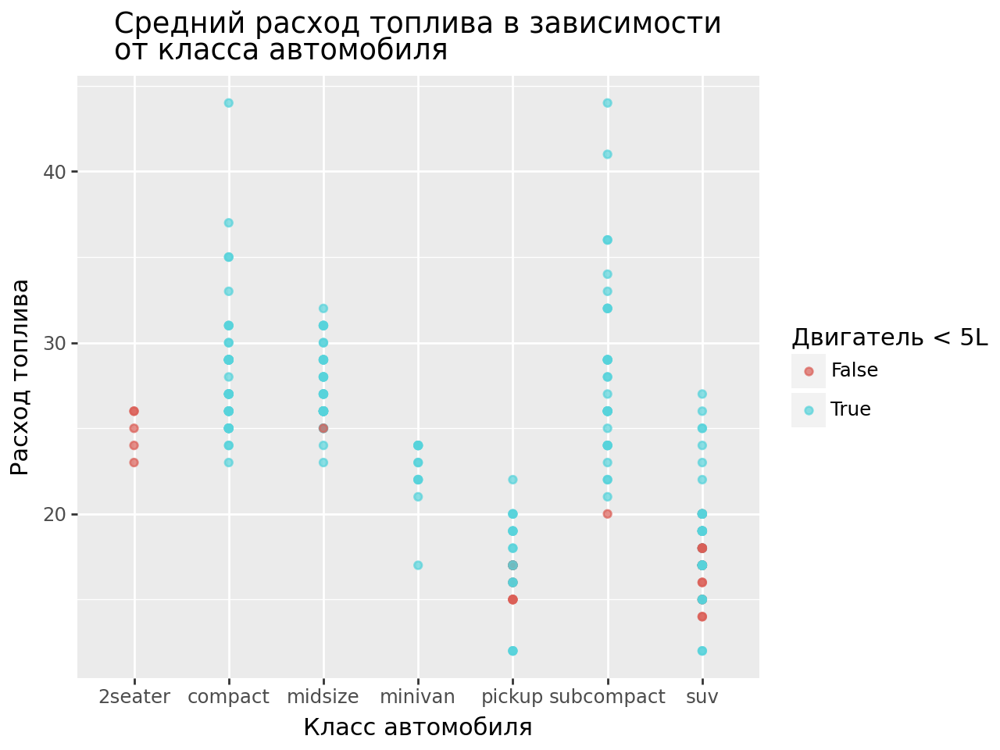

In [119]:
# Type your code here...
ggplot(mpg, aes(x='class', y='hwy', color="displ < 5")) +\
geom_point(alpha=0.7) +\
labs(title="Средний расход топлива в зависимости\nот класса автомобиля",
         x="Класс автомобиля",
         y="Расход топлива",
         color="Двигатель < 5L") 

### Попробуйте поэкспериментировать с графиками, где одной категории соответствуют различные визуальные элементы (пример ниже). Попробуйте привести пример, когда это имеет смысл.

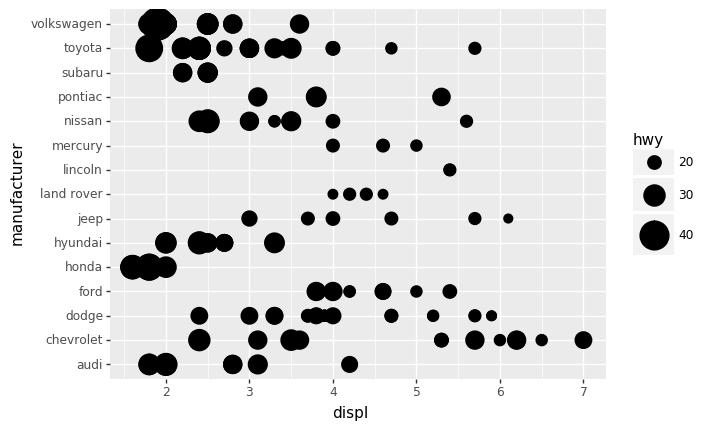

<ggplot: (-9223371871808028632)>

In [13]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="manufacturer", stroke="hwy"))

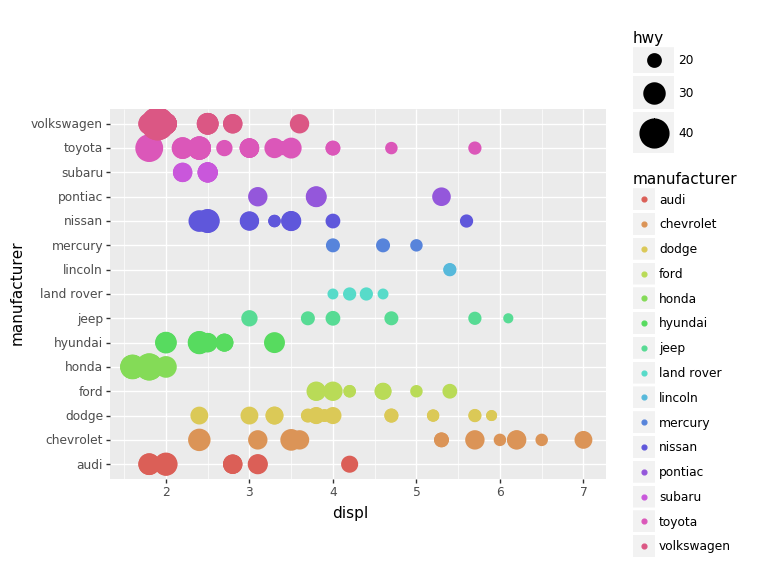

<ggplot: (-9223371871807959108)>

In [14]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="manufacturer", stroke="hwy", color="manufacturer"))

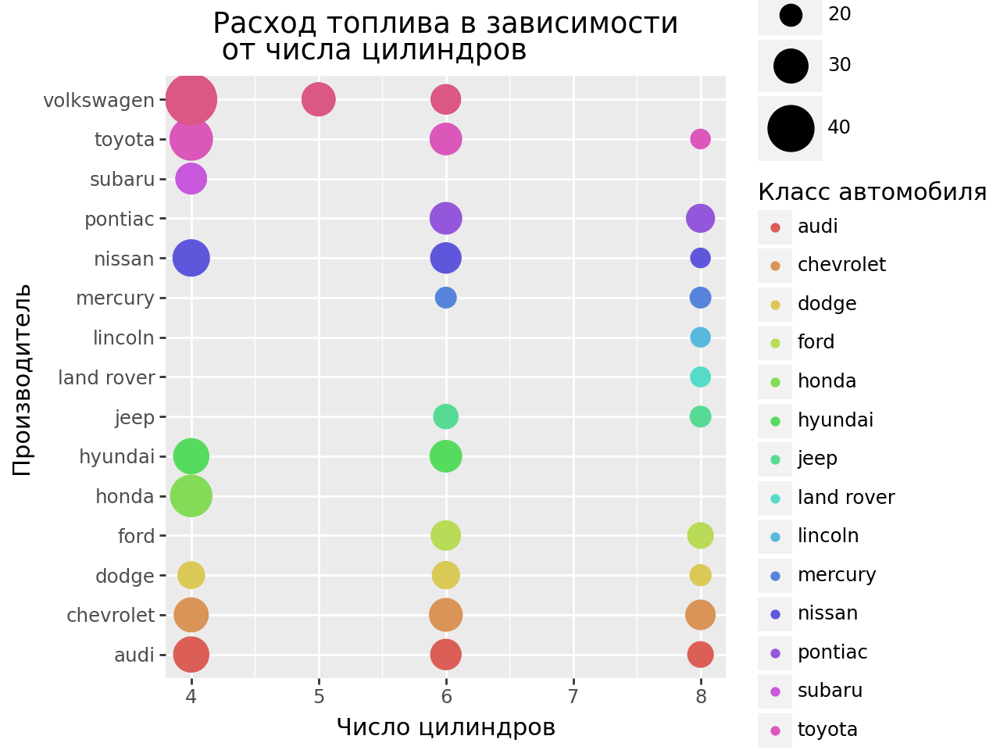

In [124]:
# Type your code here...
ggplot(data=mpg) +\
geom_point(mapping=aes(x="cyl", y="manufacturer", stroke="hwy", color="manufacturer")) +\
labs(title="Расход топлива в зависимости\n от числа цилиндров",
         x="Число цилиндров",
         y="Производитель",
         color="Класс автомобиля")

Нужен для более приятного сравнения.

## Использование панелей при визуализации

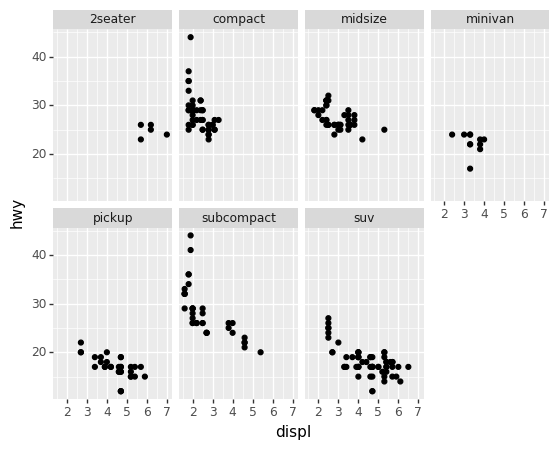

<ggplot: (-9223371871808784336)>

In [16]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy")) +\
facet_wrap("class", nrow=2)

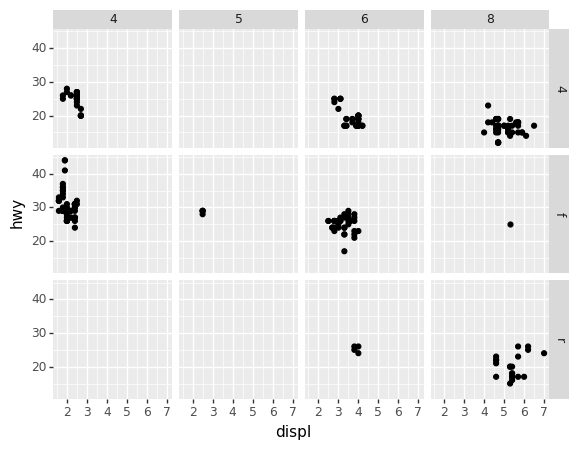

<ggplot: (-9223371871808092076)>

In [17]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy")) +\
facet_grid("drv ~ cyl")

### Что если использовать категорию с непрерывными значениями (например, hwy) для разделения на панели?

In [130]:
mpg['hwy_category'] = pd.cut(mpg['hwy'], 
                              bins=[10, 15, 20, 25, 30, 35], 
                              labels=['10-15', '15-20', '20-25', '25-30', '30-35'])

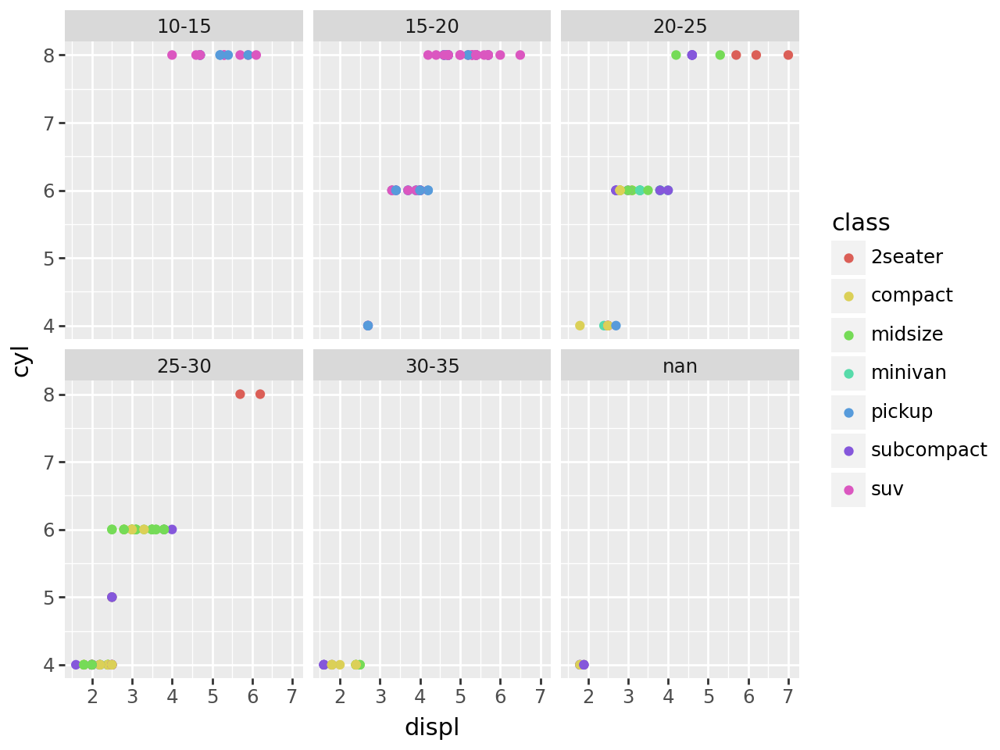

In [132]:
# Type your code here...
ggplot(data=mpg) +\
geom_point(mapping=aes(x='displ', y='cyl', color='class')) +\
facet_wrap('hwy_category', nrow=2)

### Можно сделать только вертикальные или только горизонтальные панели, если использовать конструкцию типа (". ~ <категория>")

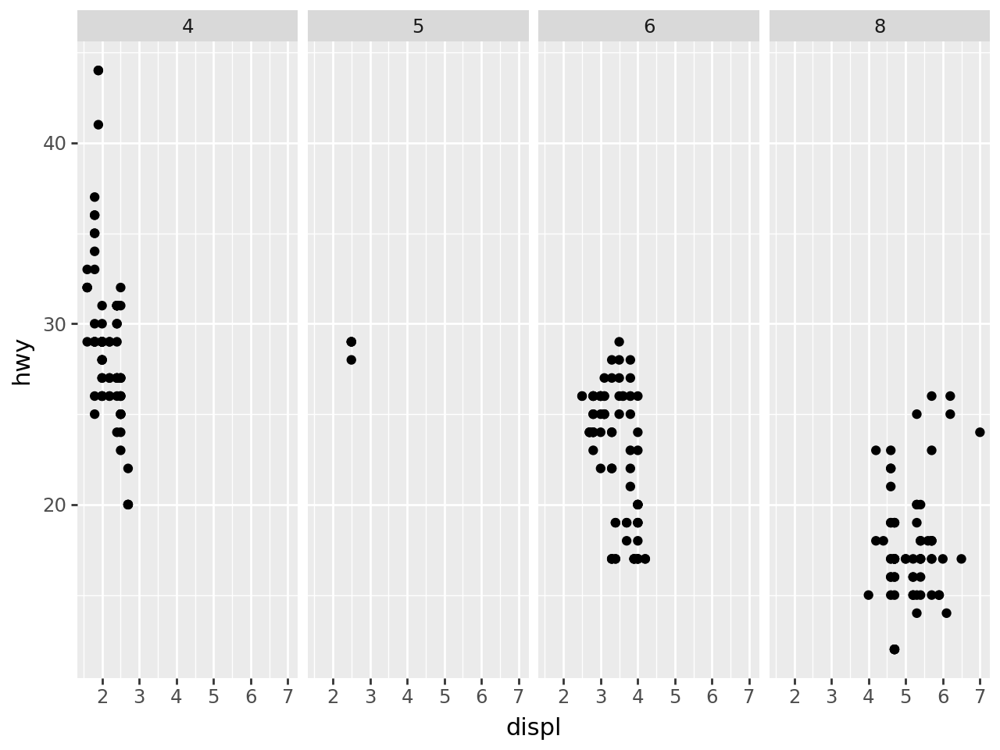

In [136]:
# Type your code here...
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy")) +\
facet_wrap('~ cyl', nrow=1)

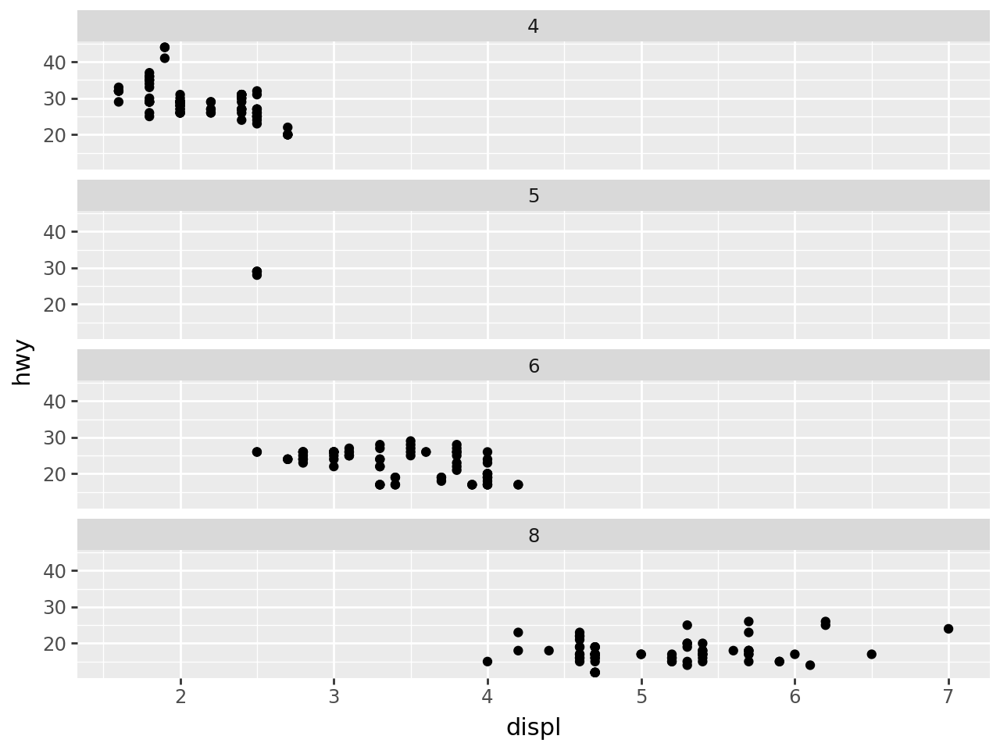

In [137]:
# Type your code here...
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy")) +\
facet_wrap('~ cyl', ncol=1)

### Что лучше использовать: цвета или панели? А для большого набора?

Для большого набора удобнее будет использовать категории, а цвета будут полезны для меньшего числа категорий.

## geom_smooth() позволяет получить сглаженную среднюю (в том числе, с доверительным интервалом).abs
### (это не сработает без библиотеки scikit-misc, и может не сработать даже с ней)

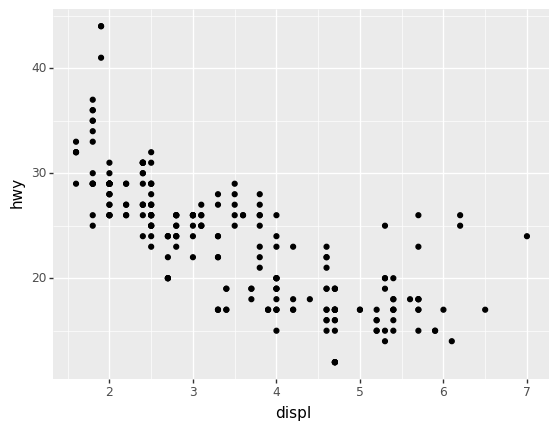

<ggplot: (-9223371871807518736)>

In [21]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy"))

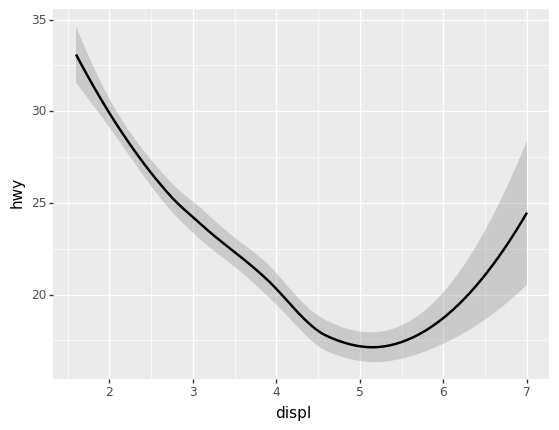

<ggplot: (-9223371871807511032)>

In [22]:
ggplot(data=mpg) +\
geom_smooth(mapping=aes(x="displ", y="hwy"))

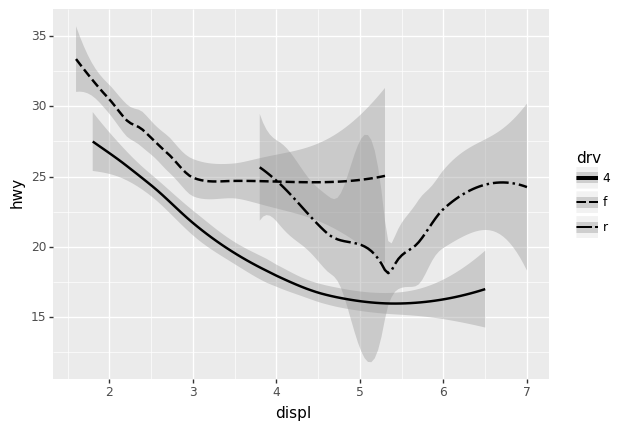

<ggplot: (-9223371871808182848)>

In [23]:
ggplot(data=mpg) +\
geom_smooth(mapping=aes(x="displ", y="hwy", linetype="drv"))

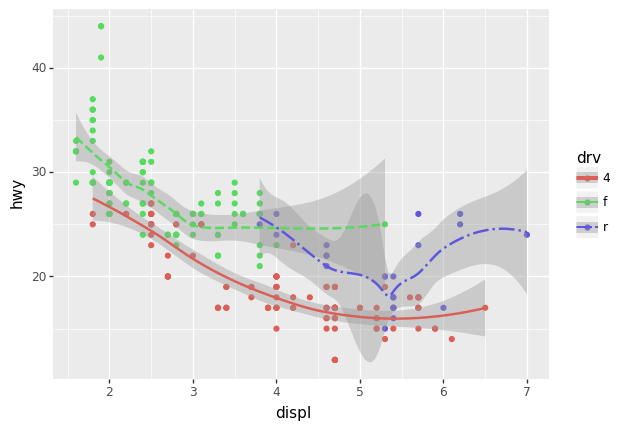

<ggplot: (-9223371871807172476)>

In [51]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy", color="drv")) +\
geom_point() +\
geom_smooth(mapping=aes(linetype="drv"))

## Визуальные отображения в функции ggplot будут распространяться на все графики. Отдельные свойства каждого геометрического отображения будут относиться только к нему.

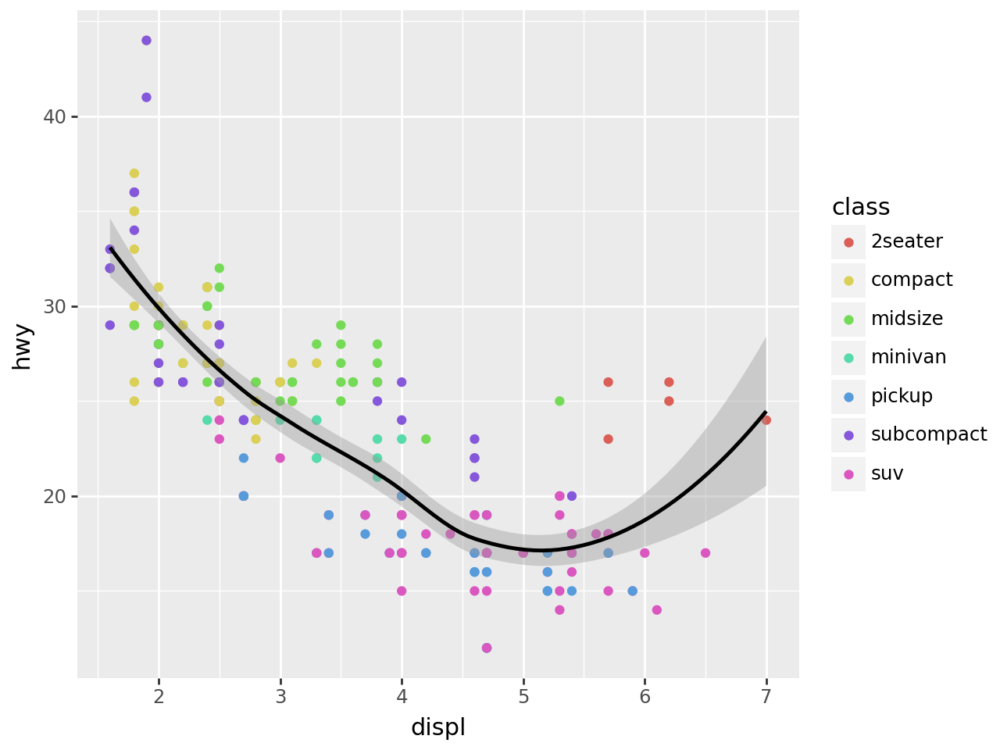

In [158]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy")) +\
geom_point(mapping=aes(color="class")) +\
geom_smooth()

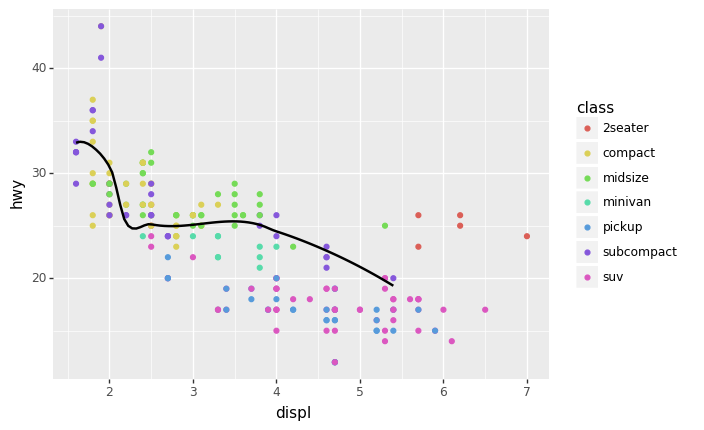

<ggplot: (-9223371871807266692)>

In [26]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy")) +\
geom_point(mapping=aes(color="class")) +\
geom_smooth(data=mpg.loc[mpg["class"] == "subcompact"], se=False)

## Попробуйте скомбинировать разные свойства разных слоёв

In [27]:
# Type your code here...

# Какое геометрическое отображение вы будете использовать, чтобы нарисовать линейную диаграмму (обычный линейный график)?

In [28]:
# Type your code here...

### Подберите подходящий код под следующие графики:
<img src="supp/p1.png" alt="Drawing" style="width: 350px;"/>
<img src="supp/p2.png" alt="Drawing" style="width: 350px;"/></br>
<img src="supp/p3.png" alt="Drawing" style="width: 350px;"/>
<img src="supp/p4.png" alt="Drawing" style="width: 350px;"/></br>
<img src="supp/p5.png" alt="Drawing" style="width: 350px;"/>
<img src="supp/p6.png" alt="Drawing" style="width: 350px;"/>

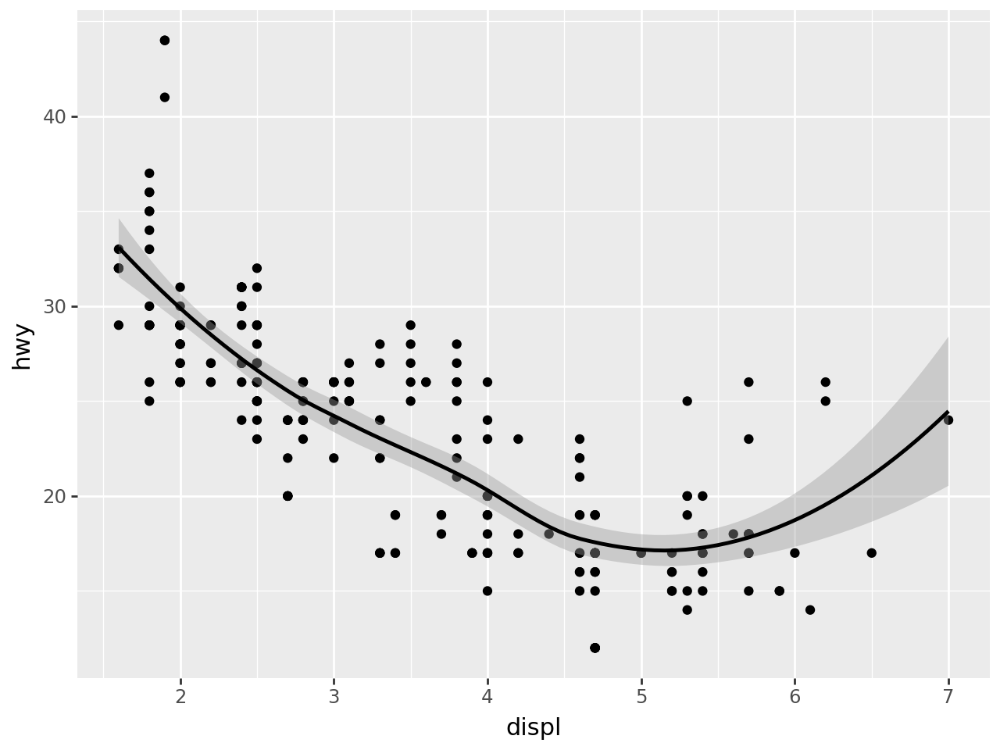

In [159]:
# Type your code here...
ggplot(data=mpg, mapping=aes(x="displ", y="hwy")) +\
geom_point() +\
geom_smooth()

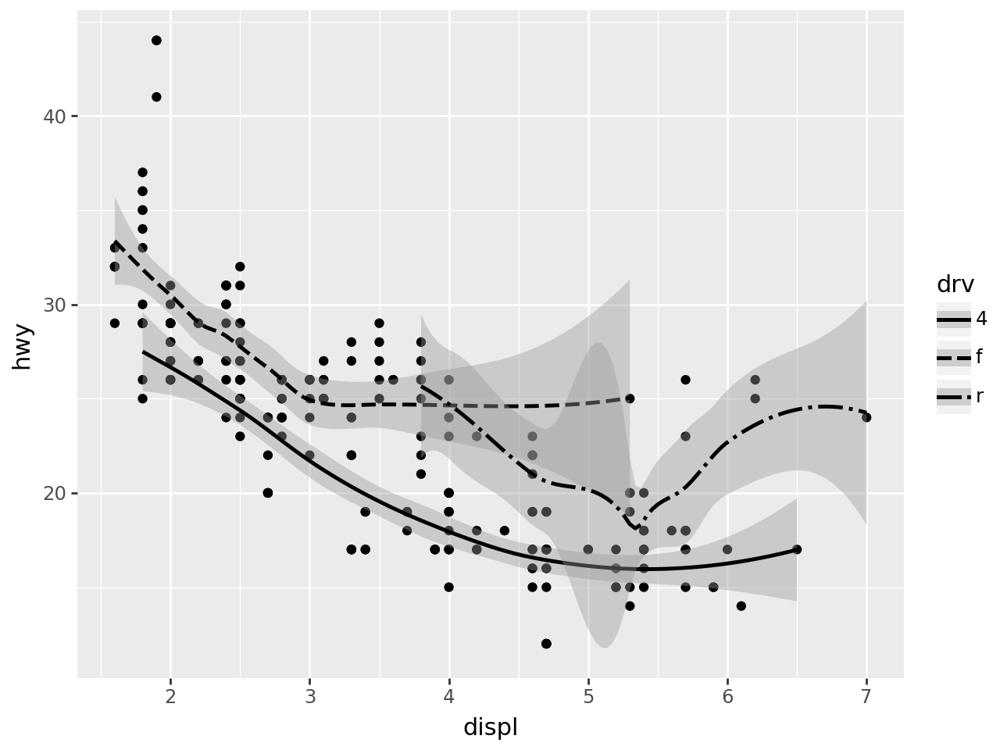

In [161]:
# Type your code here...
ggplot(data=mpg, mapping=aes(x="displ", y="hwy")) +\
geom_point() +\
geom_smooth(mapping=aes(x="displ", y="hwy", linetype="drv"))

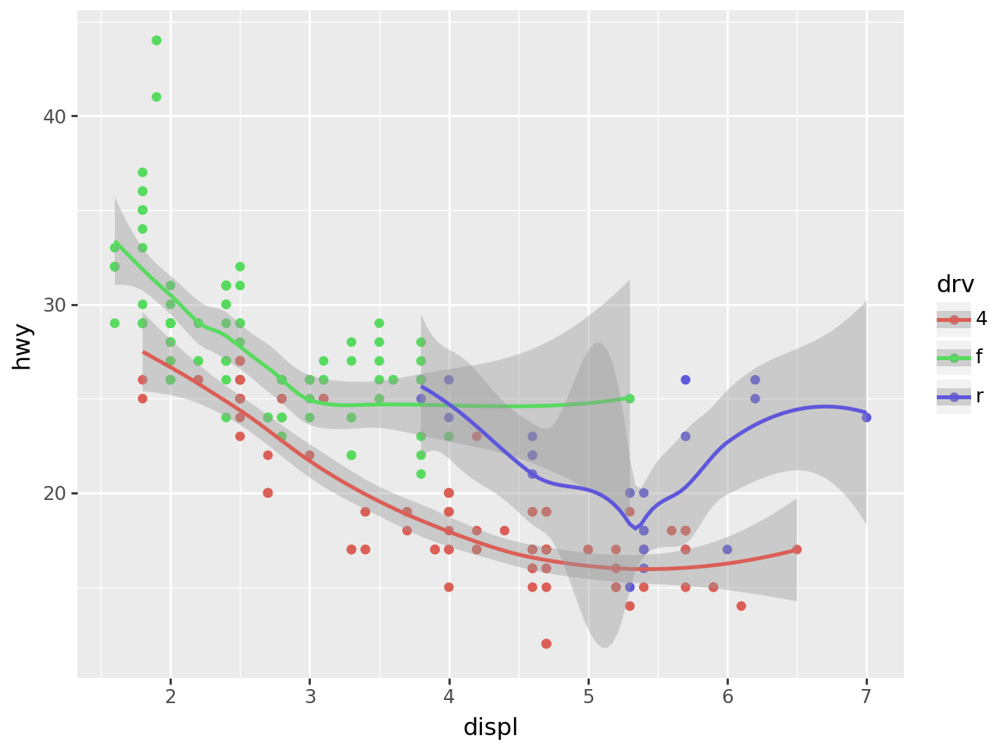

In [169]:
ggplot(data=mpg, mapping=aes(x="displ", y="hwy", color="drv")) +\
geom_point() +\
geom_smooth(linetype='solid')

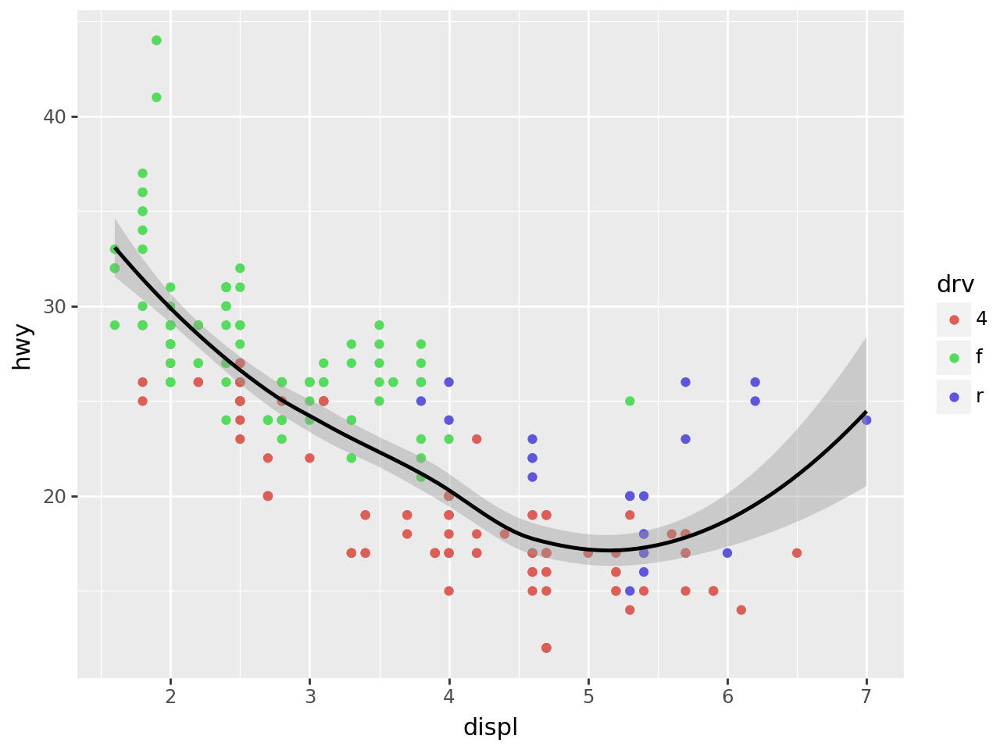

In [175]:
# Type your code here...
ggplot(data=mpg, mapping=aes(x="displ", y="hwy", color="drv")) +\
geom_point() +\
geom_smooth(color = 'black')

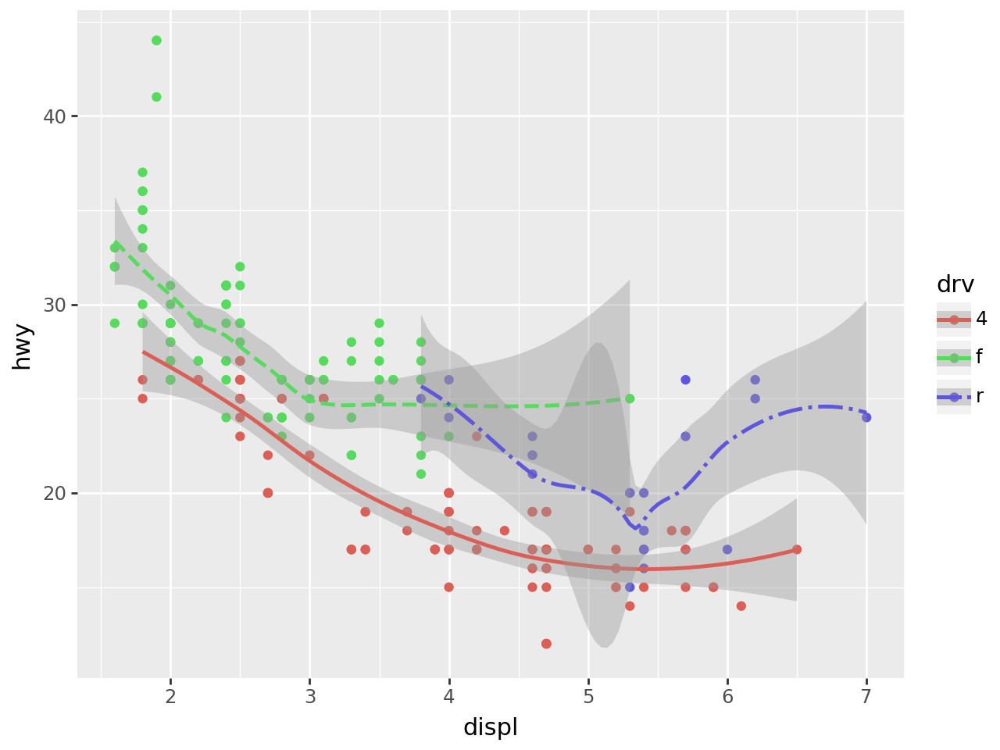

In [178]:
# Type your code here...
ggplot(data=mpg, mapping=aes(x="displ", y="hwy", color="drv")) +\
geom_point() +\
geom_smooth(mapping=aes(linetype="drv"))

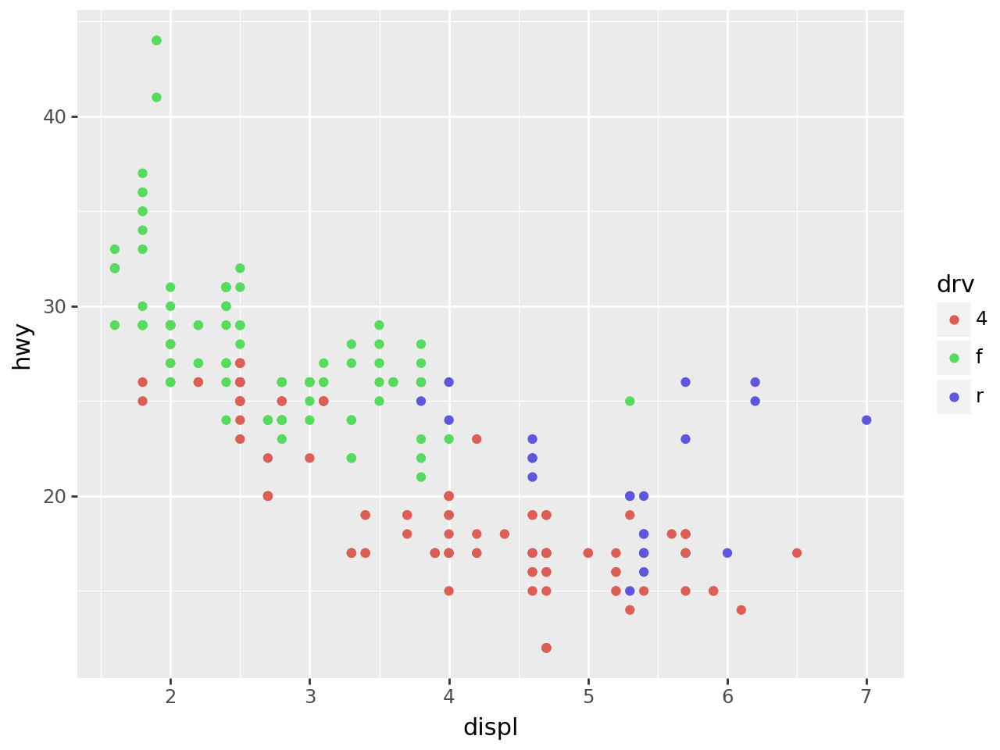

In [179]:
# Type your code here...
ggplot(data=mpg, mapping=aes(x="displ", y="hwy", color="drv")) +\
geom_point()

## Статистические свойства элементов категорий

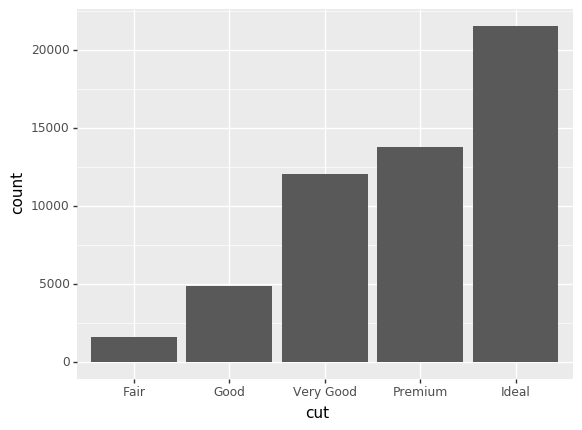

<ggplot: (-9223371871807217240)>

In [35]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut"))

### Что делает geom_col()? Чем он отличается от geom_bar()?

geom_col() принимает уже посчитанные данные

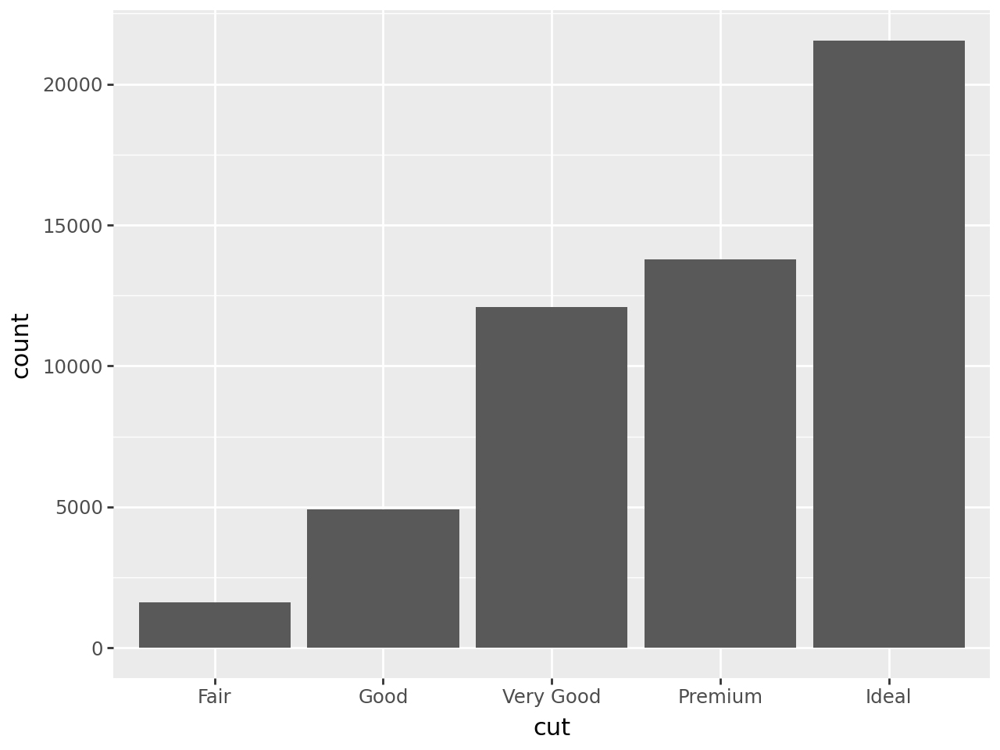

In [182]:
# Type your code here...
count_by_cut = diamonds['cut'].value_counts().reset_index()
count_by_cut.columns = ['cut', 'count']
ggplot(data=count_by_cut, mapping=aes(x='cut', y='count')) +\
geom_col()

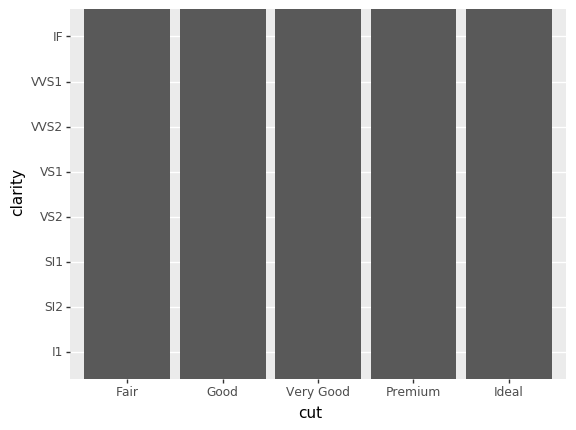

<ggplot: (-9223371871807350972)>

In [37]:
ggplot(data=diamonds) +\
geom_col(mapping=aes(x="cut", y="clarity"))

### Что произойдёт, если 
'ggplot(data=diamonds) +\
'geom_bar(mapping=aes(x="cut", y="..prop.."), group=1)
или
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="color", y="..prop.."))
### запустить без "group=1"? Почему?

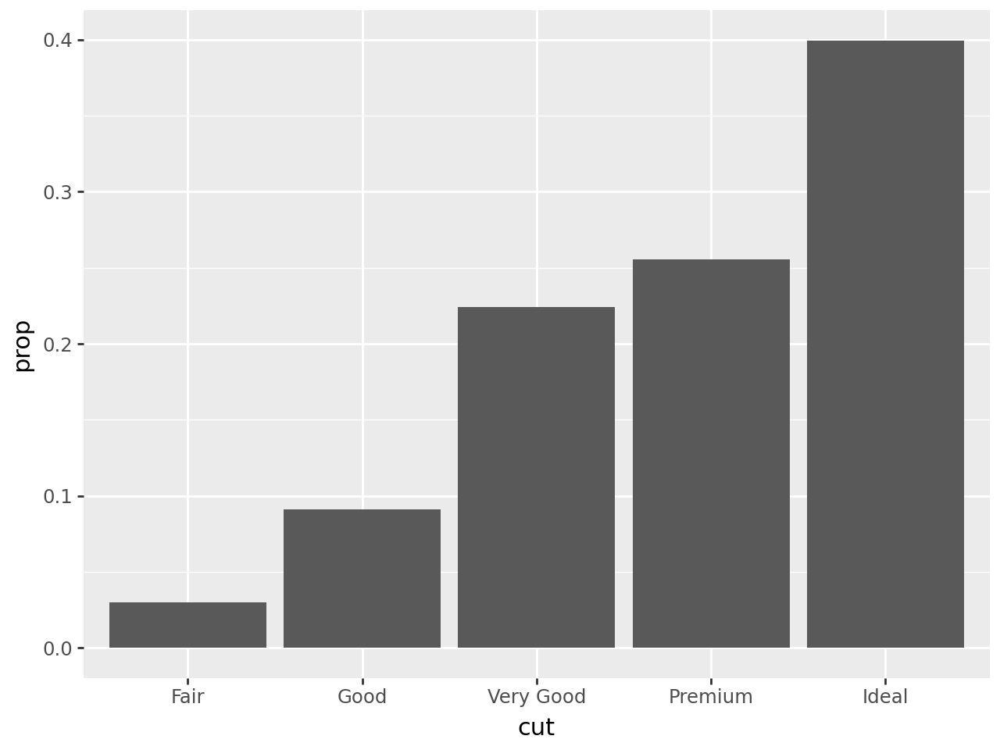

In [187]:
# Type your code here...
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", y="..prop.."), group=1) 

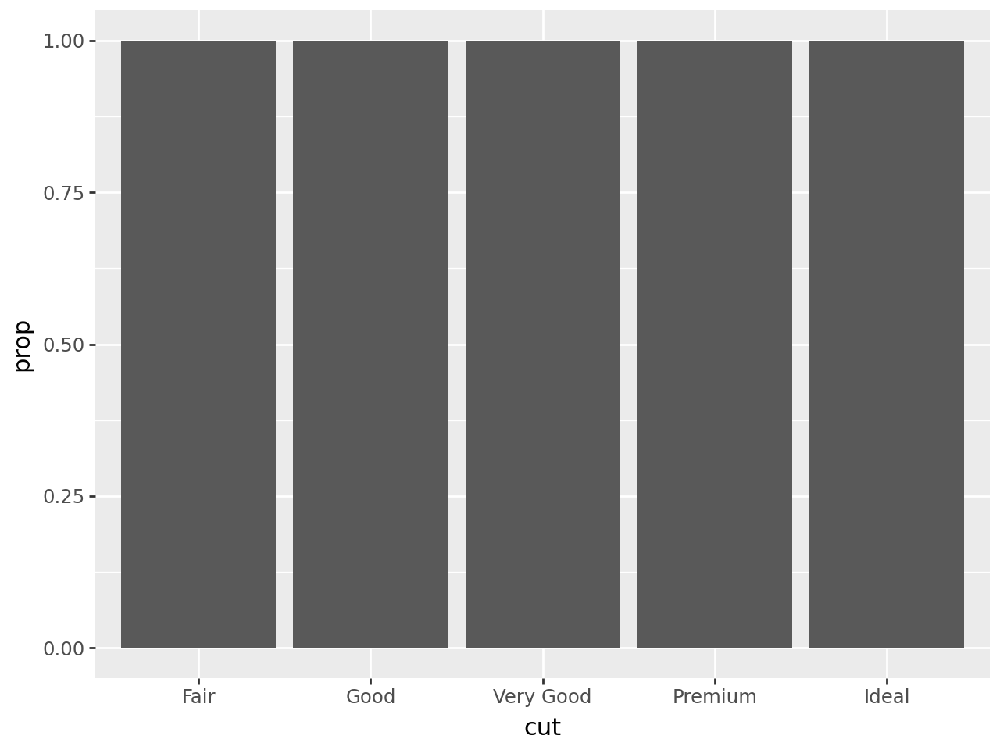

In [186]:
# Type your code here...
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", y="..prop..")) 

При group=1 считается пропорция относительно общего числа данных

## Модные графики с красивыми цветами

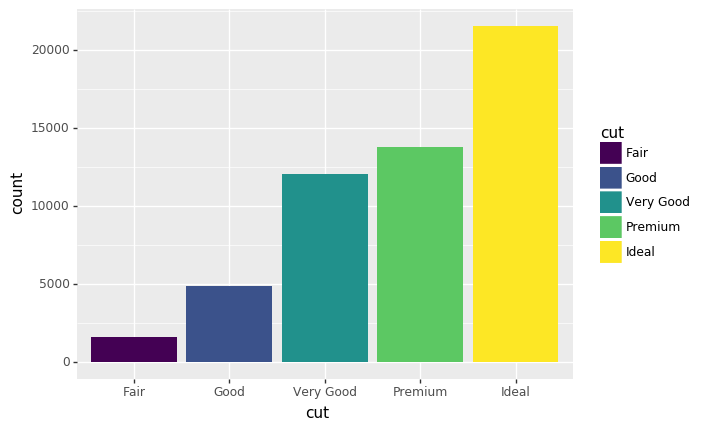

<ggplot: (-9223371871807233136)>

In [40]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="cut"))

## При добавлении новых категорий в качестве цвета появляется новая функциональность

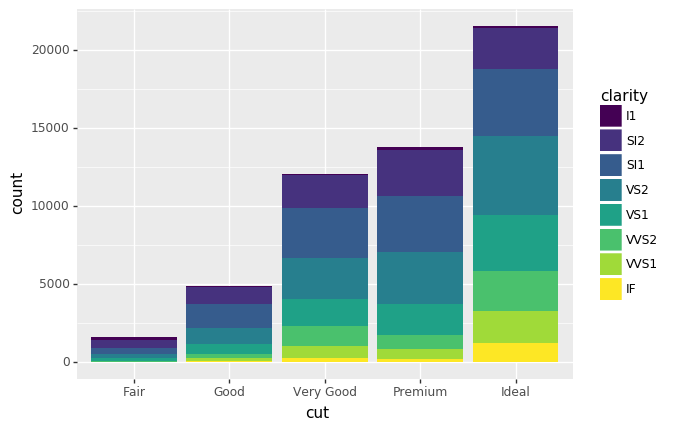

<ggplot: (-9223371871807213256)>

In [41]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="clarity"))

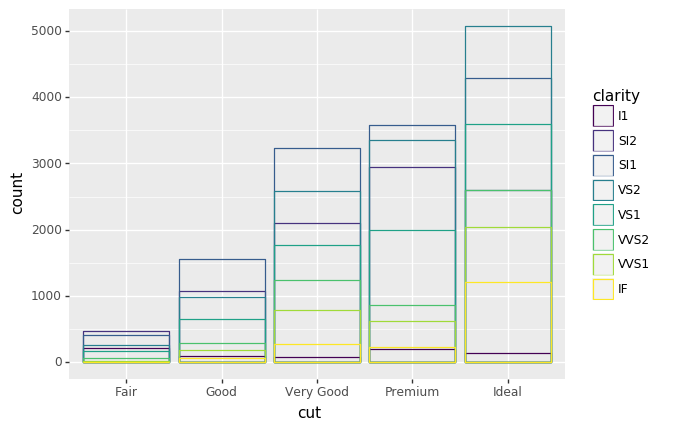

<ggplot: (-9223371871807570776)>

In [42]:
ggplot(data=diamonds, mapping=aes(x="cut", colour="clarity")) +\
geom_bar(fill=None, position="identity")

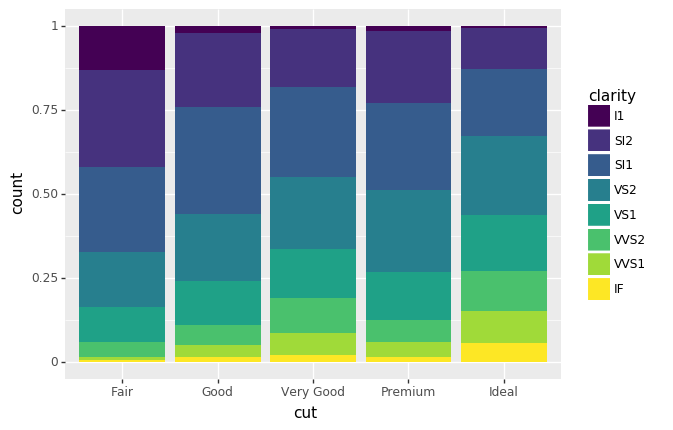

<ggplot: (-9223371871807389036)>

In [43]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="clarity"), position="fill")

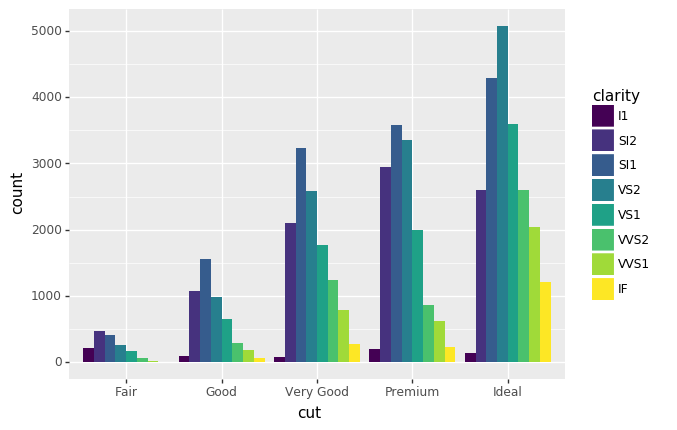

<ggplot: (-9223371871807689112)>

In [44]:
ggplot(data=diamonds) +\
geom_bar(mapping=aes(x="cut", fill="clarity"), position="dodge")

## Добавим jitter в scatter!

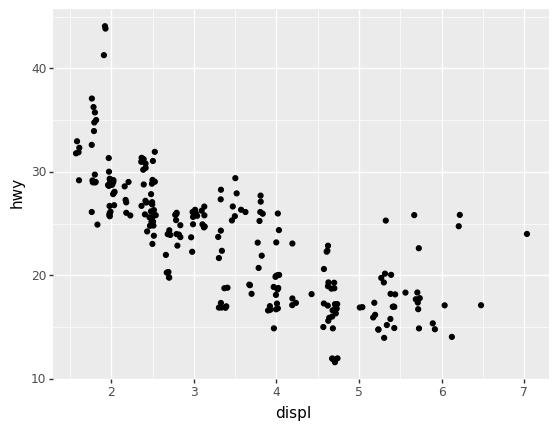

<ggplot: (-9223371871808166468)>

In [45]:
ggplot(data=mpg) +\
geom_point(mapping=aes(x="displ", y="hwy"), position="jitter")


### Зачем тут coord_fixed()? Что делает geom_abline()?

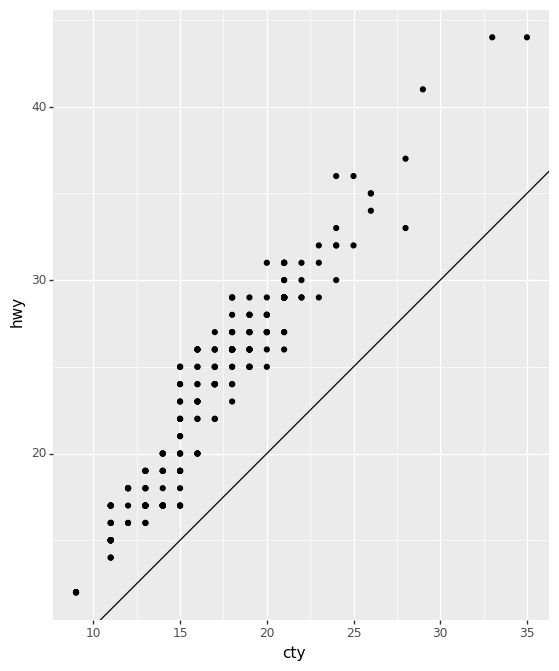

<ggplot: (-9223371871807976356)>

In [48]:
ggplot(data=mpg, mapping=aes(x="cty", y="hwy")) +\
geom_point() +\
geom_abline() +\
coord_fixed()


coord_fixed() устанавливает фиксированные отношения между осями x и y  
geom_abline() добавляет прямую линию на график с заданным наклоном и смещением

# Творческое задание
## Попробуйте использовать изученные средства plotnine для своего датасета (необязательно много и пока не надо строить сложные графики)

In [188]:
from sklearn.datasets import load_wine

In [189]:
wine_data = load_wine()
df_wine = pd.DataFrame(data=wine_data.data, columns=wine_data.feature_names)
df_wine['target'] = wine_data.target

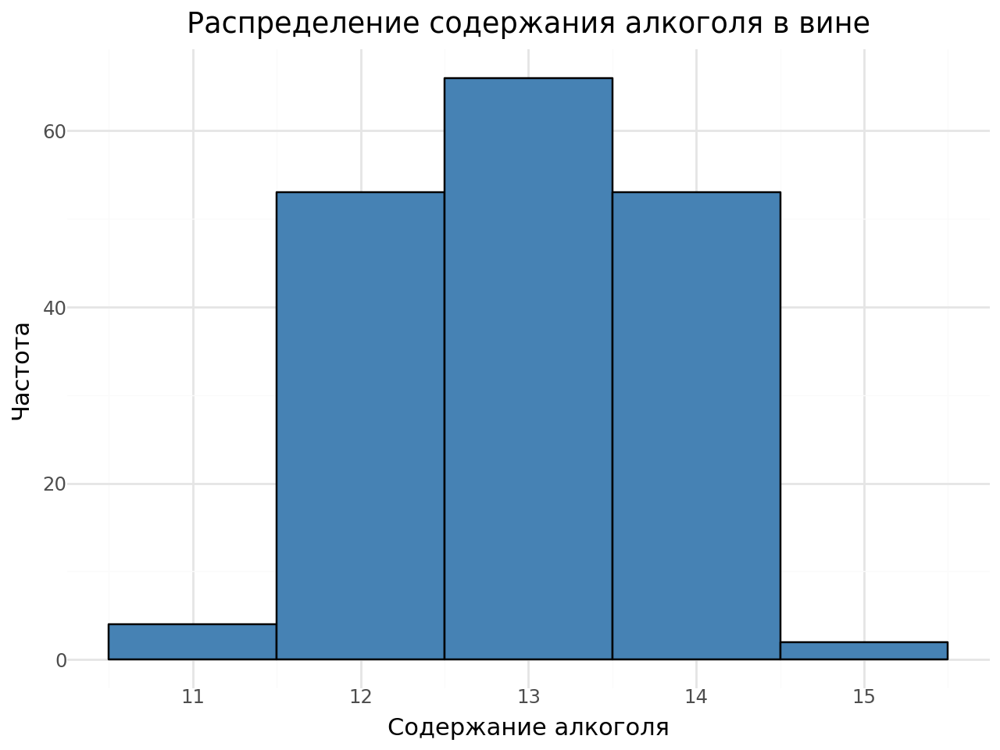

In [192]:
ggplot(data=df_wine, mapping=aes(x='alcohol')) + \
geom_histogram(binwidth=1, fill='steelblue', color='black') + \
labs(title='Распределение содержания алкоголя в вине',
         x='Содержание алкоголя',
         y='Частота') + \
theme_minimal()

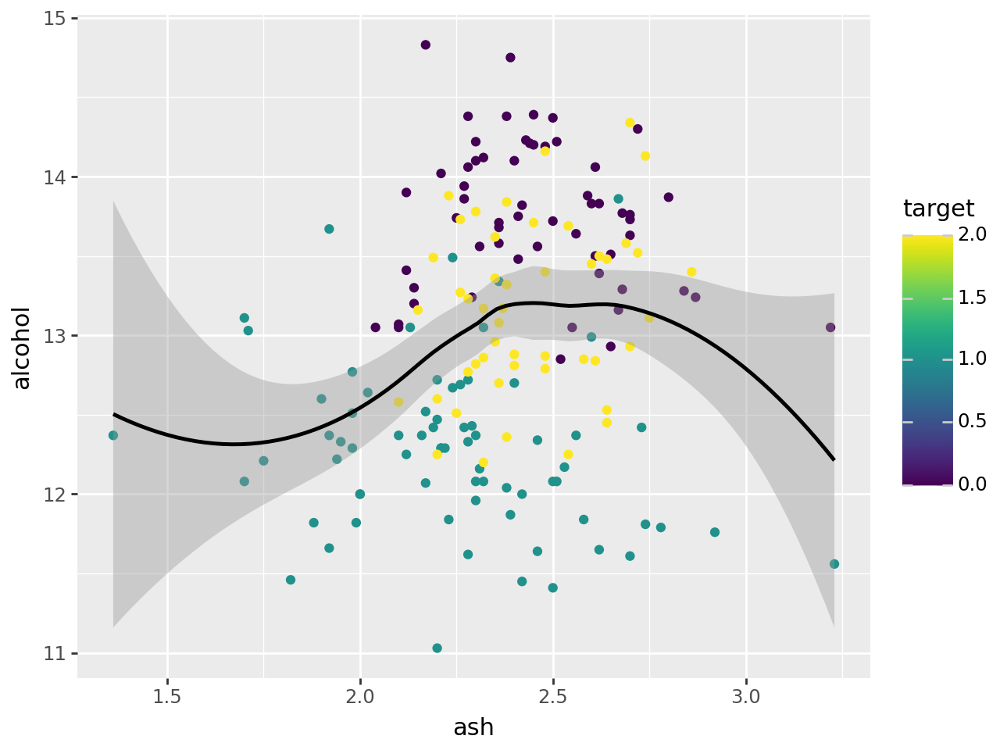

In [201]:
ggplot(data=df_wine, mapping=aes(x="ash", y="alcohol", color="target")) +\
geom_point() +\
geom_smooth(color = 'black')

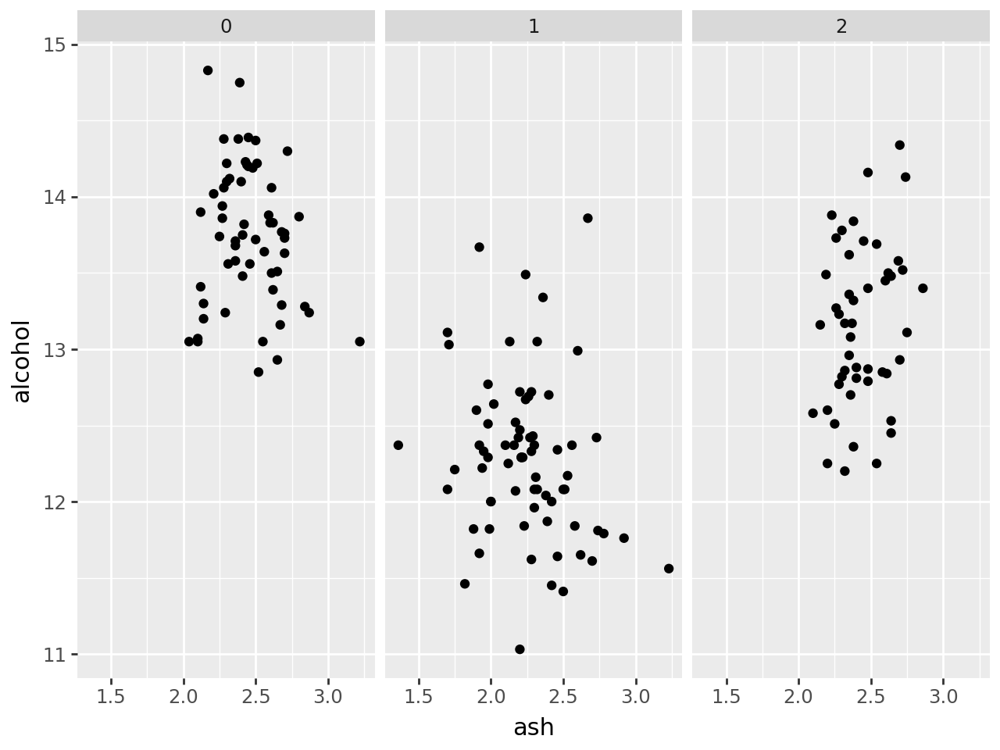

In [207]:
ggplot(data=df_wine) +\
geom_point(mapping=aes(x="ash", y="alcohol")) +\
facet_wrap('~ target', nrow=1)